In [6]:
using Plots, IJulia

I want to make sure that I have a model that works as well as possible before I start implementing different inductive bias ideas. I implemented martins model in Lux, and worked on stabilization. The coming examples come from these base settings: nx=100, Lx=10.0, ν=0.1, k=2*pi/L, u_mean=1, u_amplitude=0.5, t_end=15, CFL_out=0.8

I normalize the features bu subtracting the mean, and dividing by the standard deviation. I also implement a learning rate scheduler that reduces the learning rate over learning epochs.

We see a very nice correspondance between the target solution and the unrolled solution. We can calculate the mean squared error at a given timestep and get an error over time, which we can see is pretty low. I also calculated the total mass in the system over time. We can see that the target solution actually losses some mass, which is unphysical, in the future we might want a more accurate target solution.

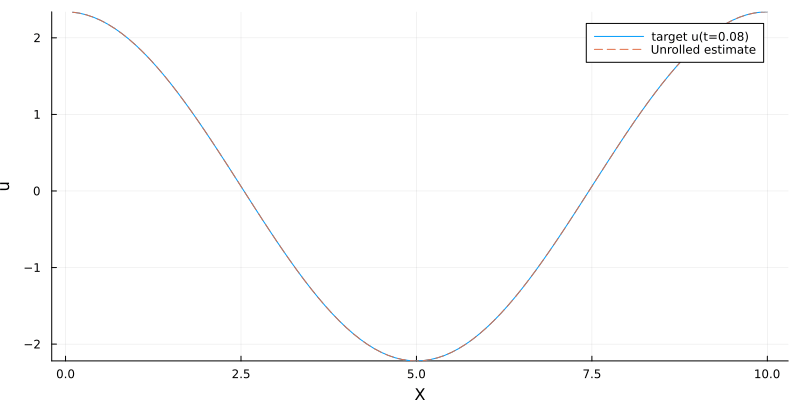

In [7]:
display("image/gif", read("media/base_unroll.gif"))

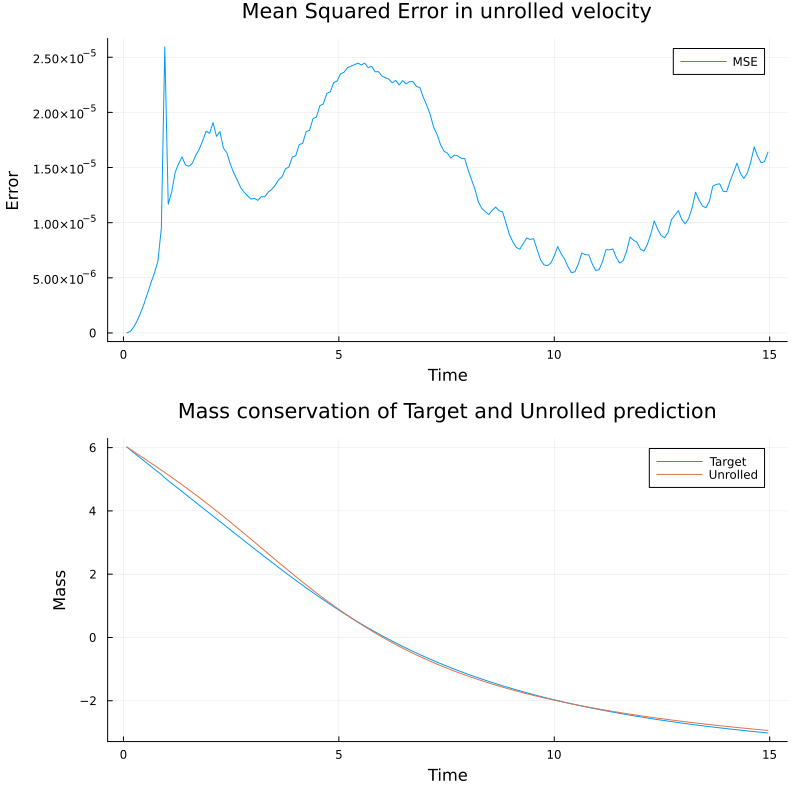

In [8]:
display("image/png", read("media/base_plots.png"))

It is now very interesting to see if the model actually learned anything about the underlying equations, therefore we can give other initial conditions as input and see if the unrolled solution is still good. Here we test with k=4*pi/L.

Very nice result, we still see a very close reconstruction. The error is about an order of magnitude higher, and we see a difference in the mass, which I think is just a part of the reconstruction loss, not a feature of the model.

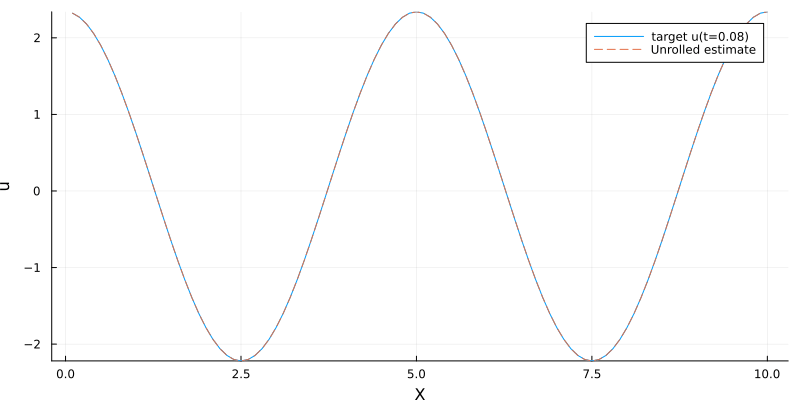

In [9]:
display("image/gif", read("media/base_model_k4.gif"))

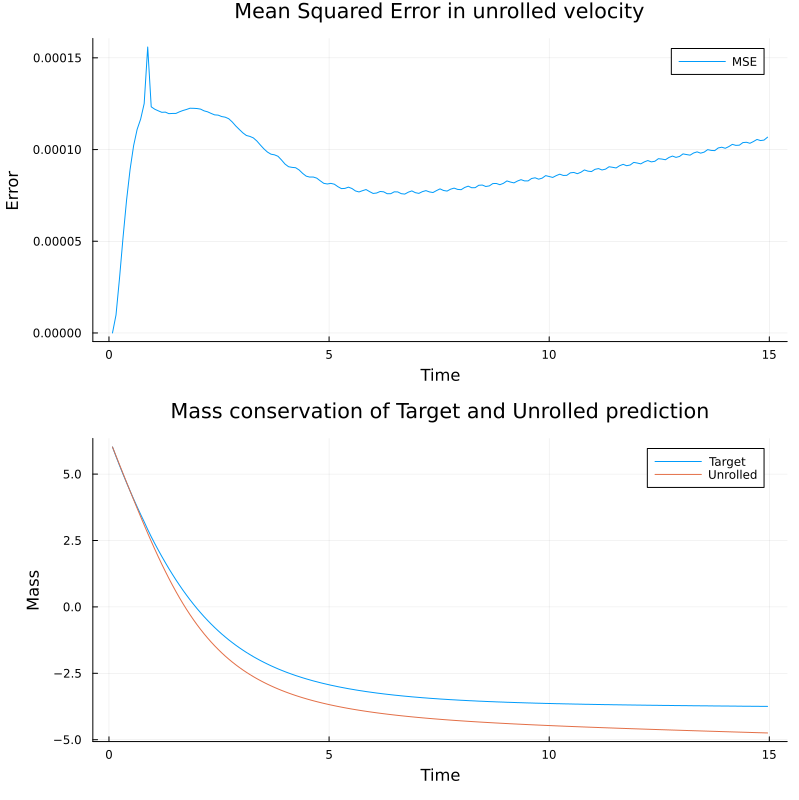

In [10]:
display("image/png", read("media/base_model_k4.png"))

Another test to run is if if the model is still capable of prediction when the end time is larger than what it was trained on. Here we extend the time domain to t_end=30.

We can see that the model still works very well even when extrapolating to twice the trained end time. Also notice the characteristic shape of the error plot. We quickly go to a high error, as velocities are high, and therefore even small relative errors give a large absolute error. A bit later the solution gets more damped, and the absolute error decreases. But then for the larger timescales we see that the error again increases, as small errors in the reconstruction build up.

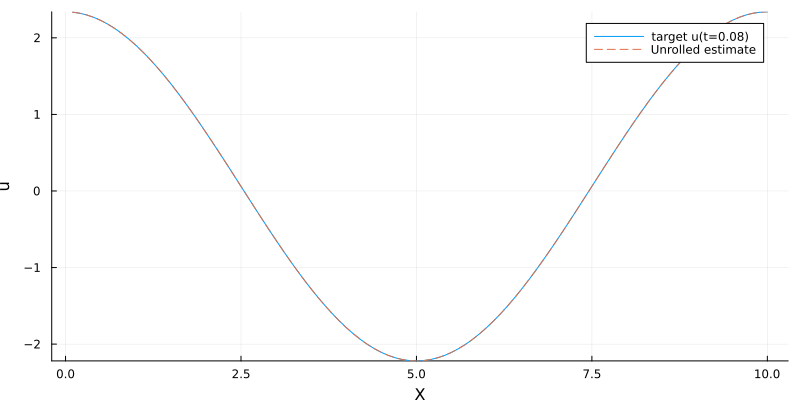

In [11]:
display("image/gif", read("media/base_model_t_end30.gif"))

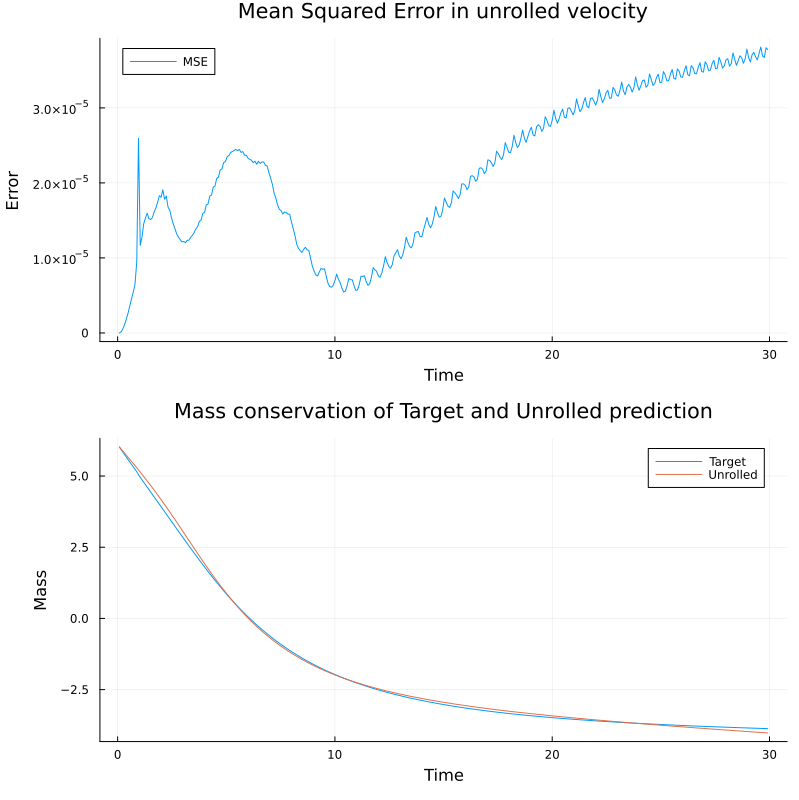

In [12]:
display("image/png", read("media/base_model_t_end30.png"))

I also wanted to do a small sanity check, and compare with functions that had different viscosities, here for for ν = 0.5 and ν = 0.01 respectively.

Nu surprises here, the target solution either diffuses less, or more, depending on the viscosity.

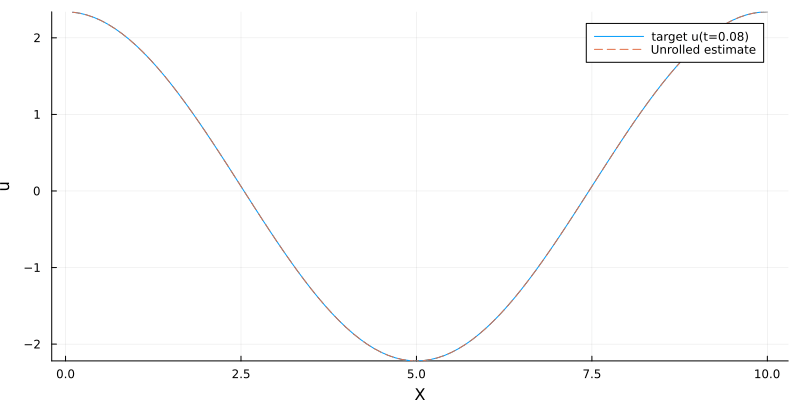

In [13]:
display("image/gif", read("media/base_model_nu0_5.gif"))

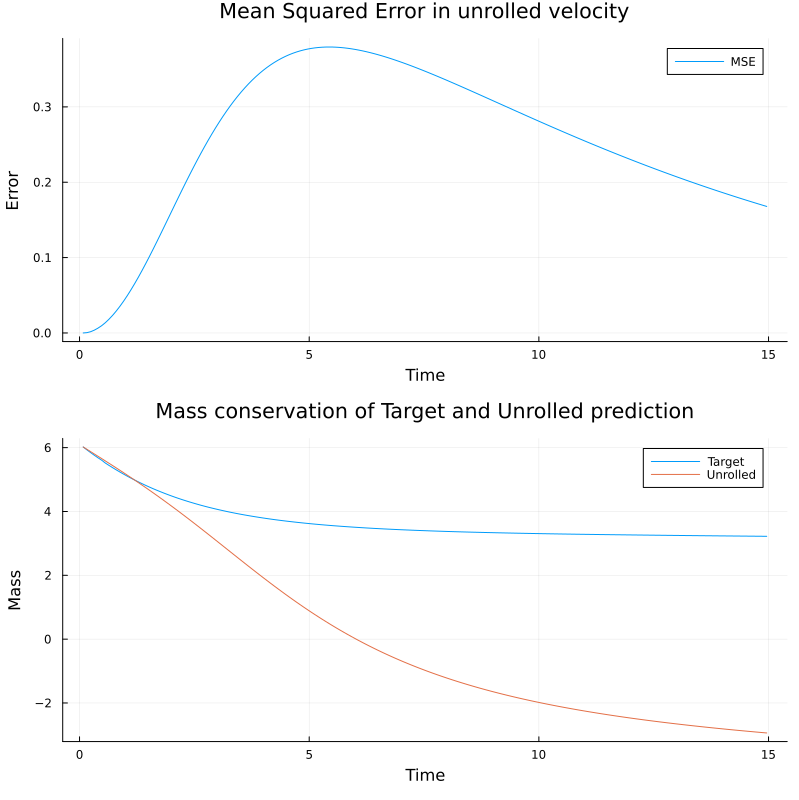

In [14]:
display("image/png", read("media/base_model_nu0_5.png"))

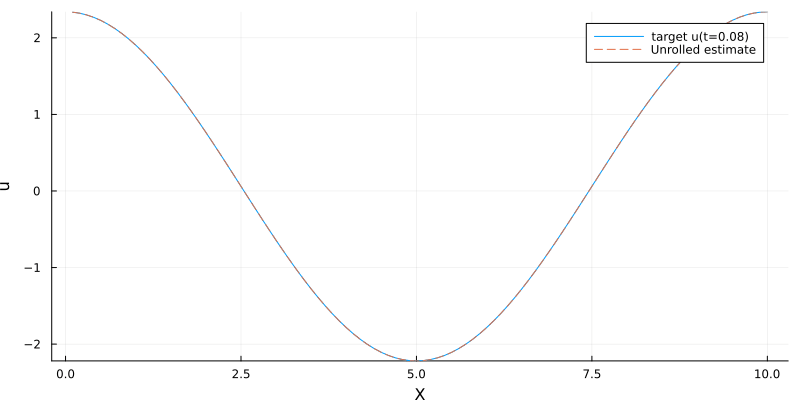

In [17]:
display("image/gif", read("media/base_model_nu0_01.gif"))

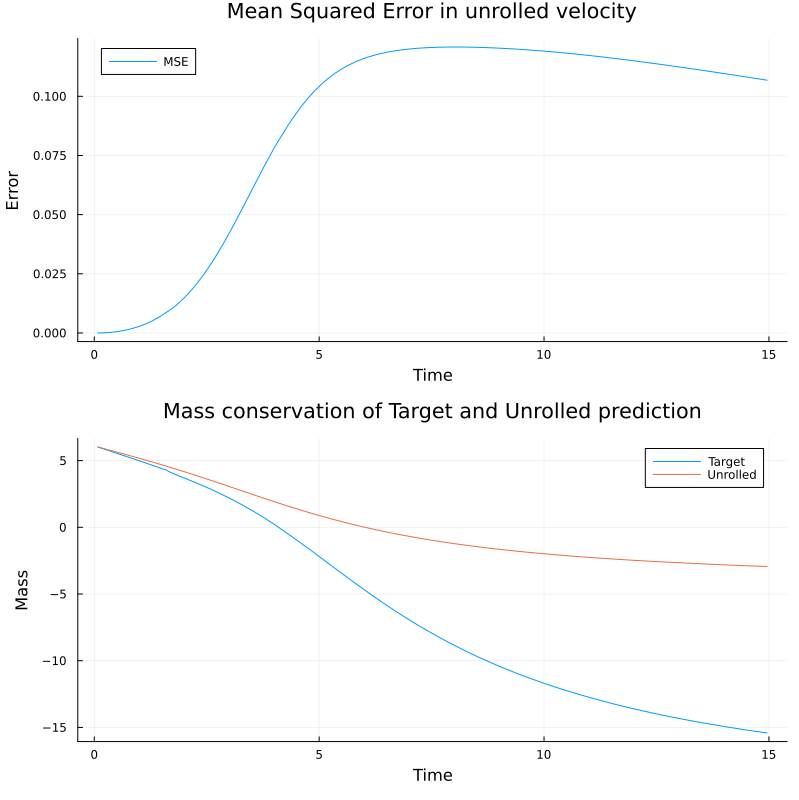

In [16]:
display("image/png", read("media/base_model_nu0_01.png"))

The next challange for the model is to see if we can mess with the wave amplitude of the initial condition. Here I use u_amplitude = 0.9.

Here we finally see the model struggeling a little bit, I am not sure why, but it might have to do with the fact that the model has never seen such high amplitudes as we get in the first timesteps here. The PDE is still the same, so this is something that the model should theoretically be able to work for.

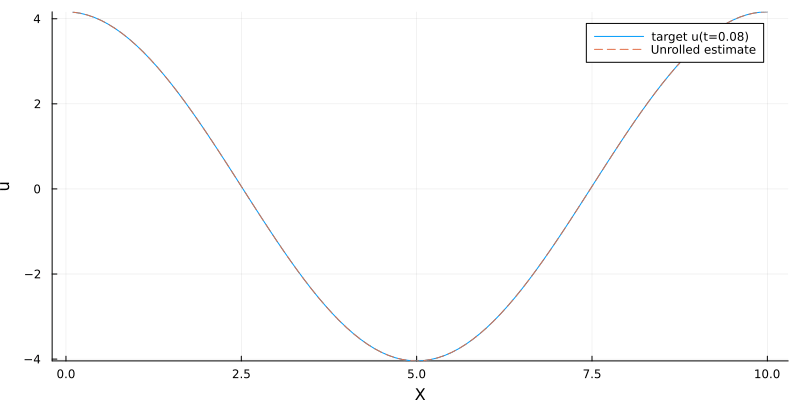

In [18]:
display("image/gif", read("media/base_model_u_amp0_9.gif"))

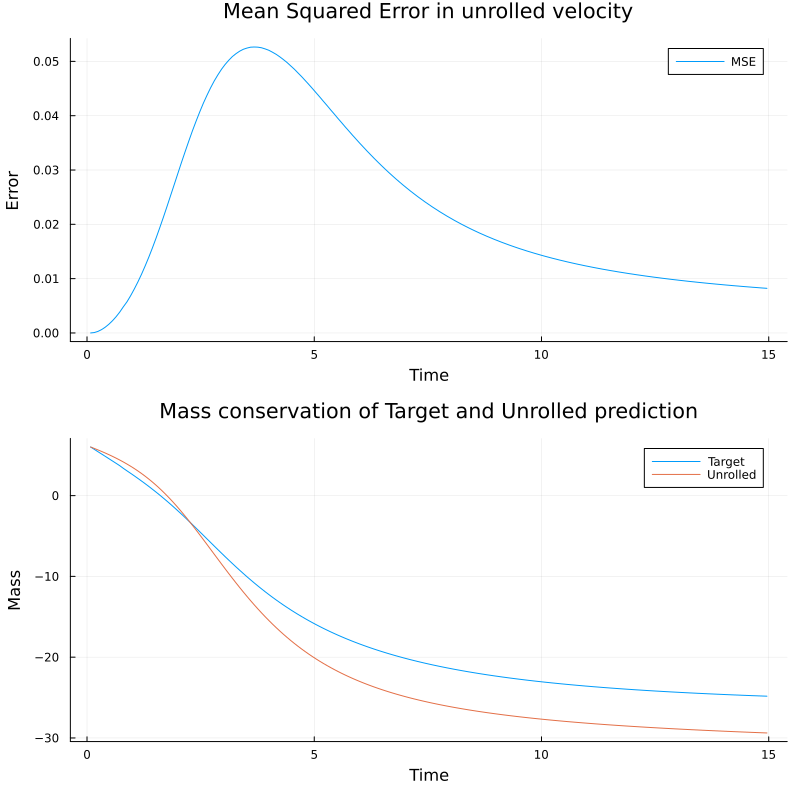

In [19]:
display("image/png", read("media/base_model_u_amp0_9.png"))

I also want to test for a different u_mean, e.g. u_mean = 1.5. I first take a naive approach by just changing the settings, generating data, and plugging it into the model.

We immidiatly see a large divergence, and after a short period, the solution become completely unstable. One big issue here, is that this reference solution does not use the same timestep, as the CLF_out is dependant on u_mean. The model is not able to currently use a different timestep than what it was trained on. With such big steps, the model eventually becomes unstable.

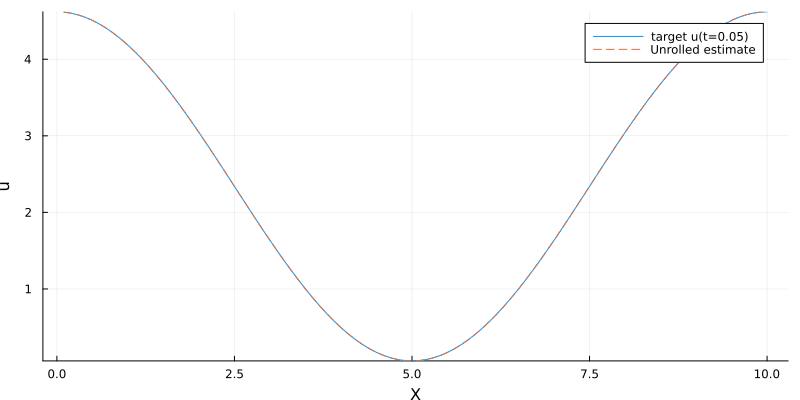

In [20]:
display("image/gif", read("media/base_model_u_mean1_5.gif"))

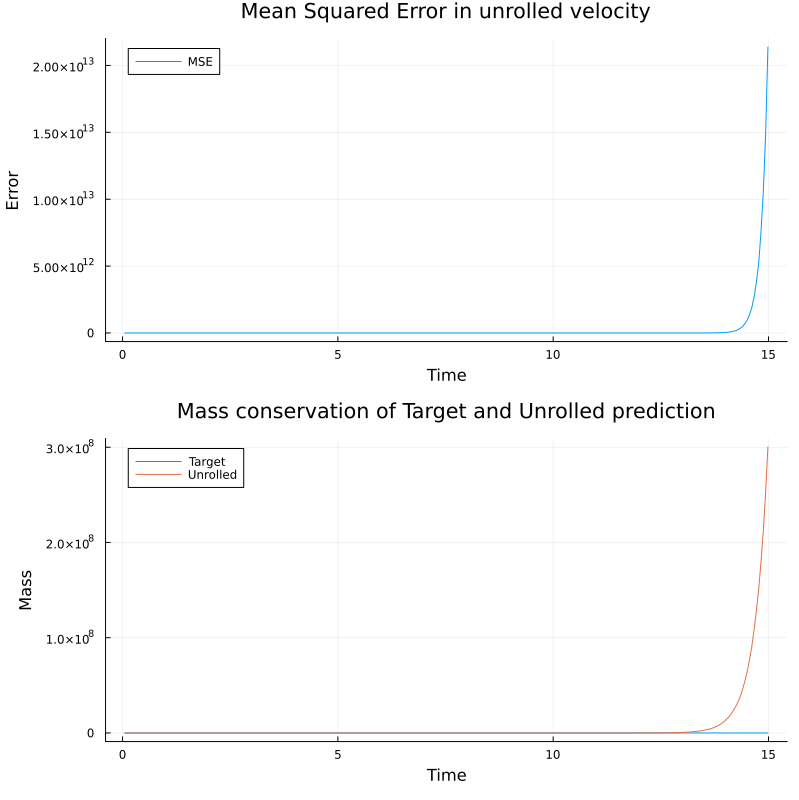

In [21]:
display("image/png", read("media/base_model_u_mean1_5.png"))

Now I want to retrain the model again at u_mean=1, but now with the dt that it would have if it had been trained on u_mean=1.5, and see if that fixes our issues.

Clearly not. This might be a limit because of the lack of data, but this is also where inductive bias could play a role, but pushing towards mass conservative solutions.

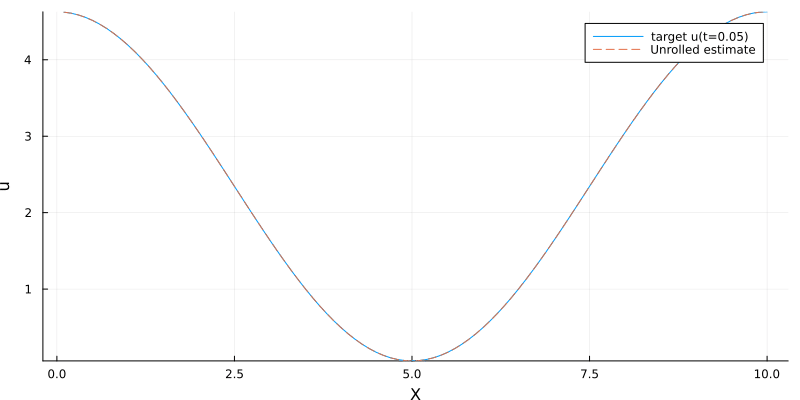

In [22]:
display("image/gif", read("media/dt_model_u_mean1_5.gif"))

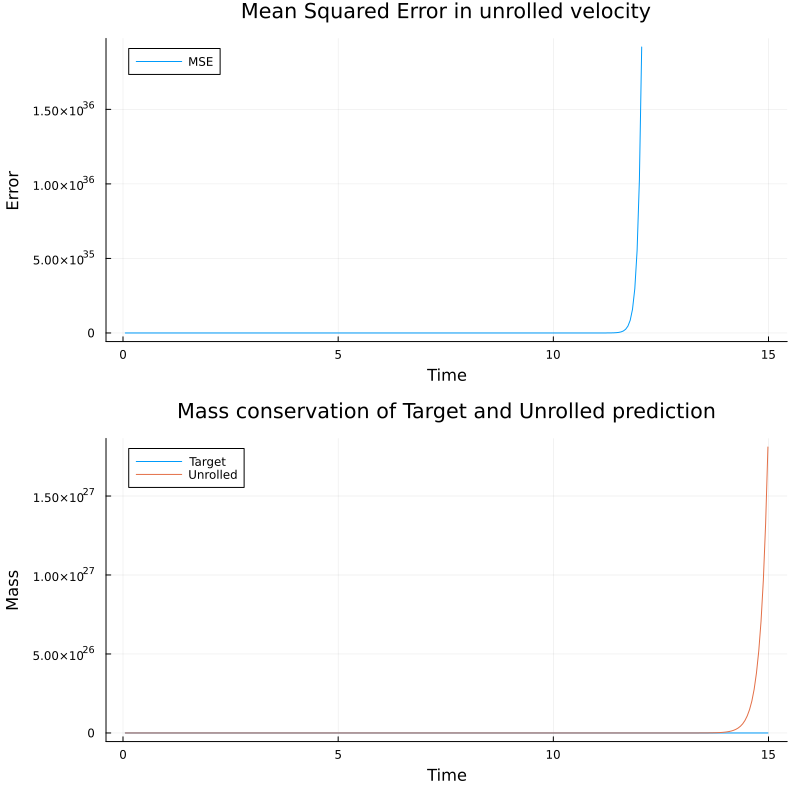

In [23]:
display("image/png", read("media/dt_model_u_mean1_5.png"))

The last thing I want to try before messing with the model, is to enrich the dataset by including the data with u_mean=1.5 into the training data.

Yes, it now does very well.

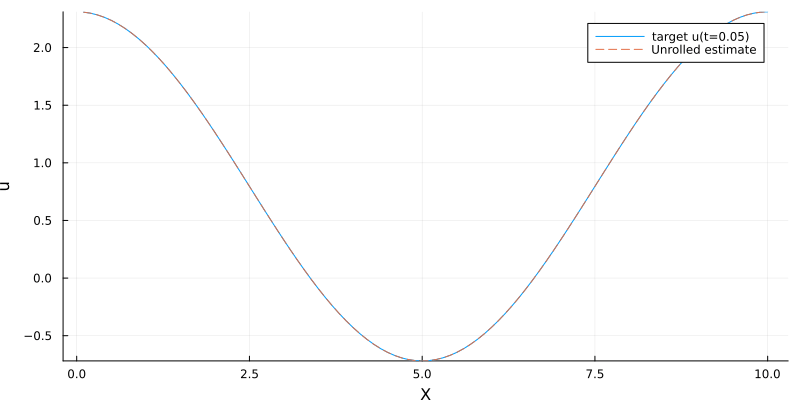

In [24]:
display("image/gif", read("media/dt_model_u_mean1_5_rich.gif"))

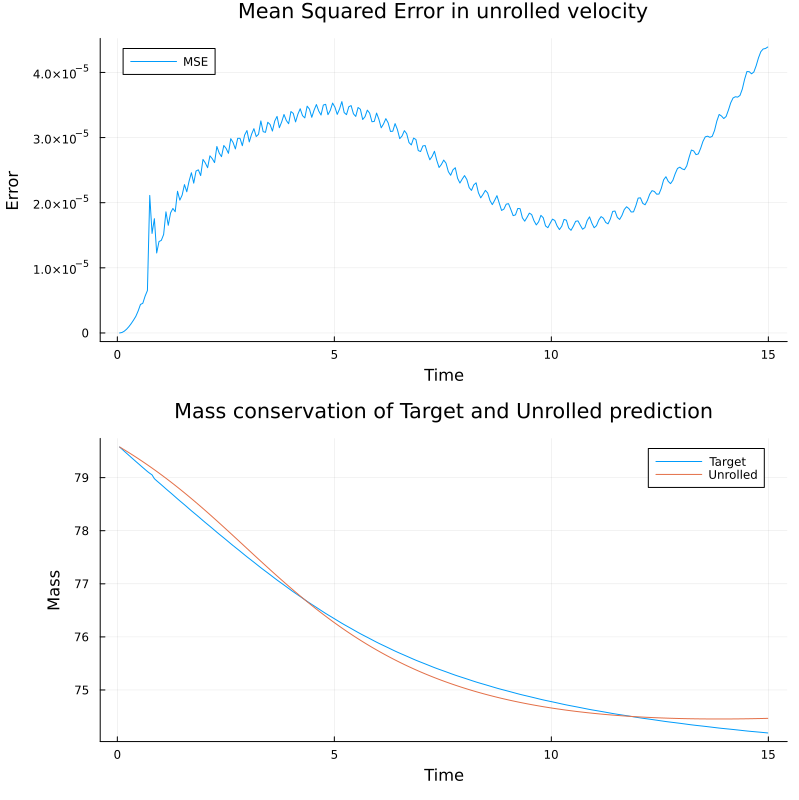

In [25]:
display("image/png", read("media/dt_model_u_mean1_5_rich.png"))

Also to test that the enriched model is still capable of unrolling the original data with u_mean=1.

It still does very well, with the error being only slightly higher than when we trained on just this dataset at higher CFL (3e-5 vs 2.5e-5).

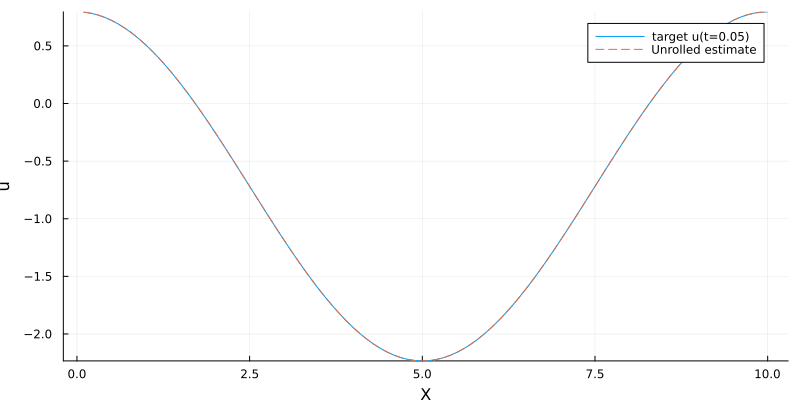

In [26]:
display("image/gif", read("media/dt_unroll_rich.gif"))

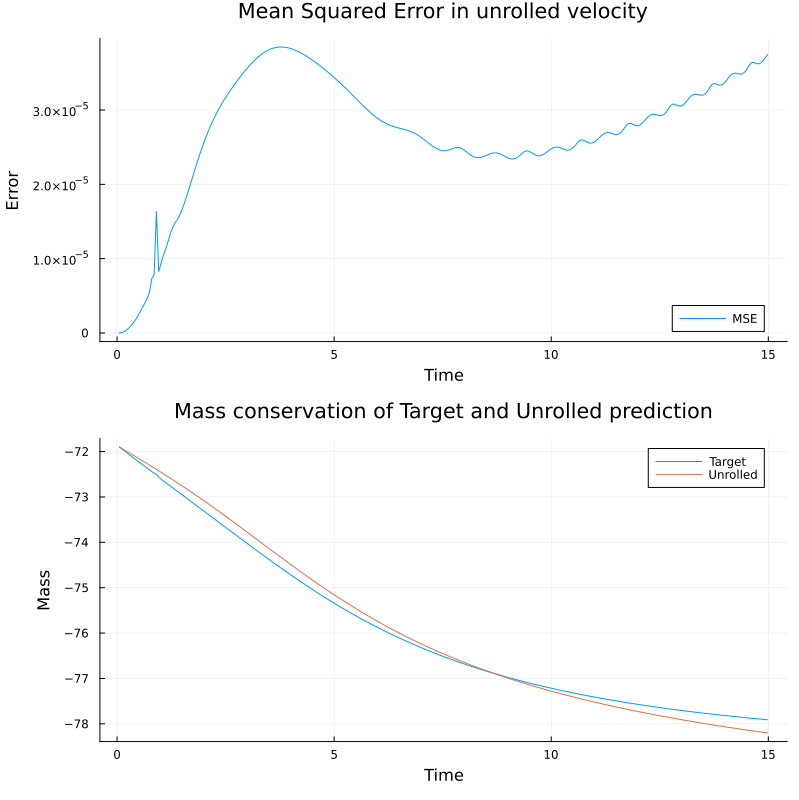

In [27]:
display("image/png", read("media/dt_plots_rich.png"))

And as a final point of interest we rerun this model on the u_amplitude=0.9 dataset, and see if the model is able to generalize better now that it has more diverse data.

And we can see that the model is now a lot better at this task, with the error being a lot lower (0.0025 vs 0.05).

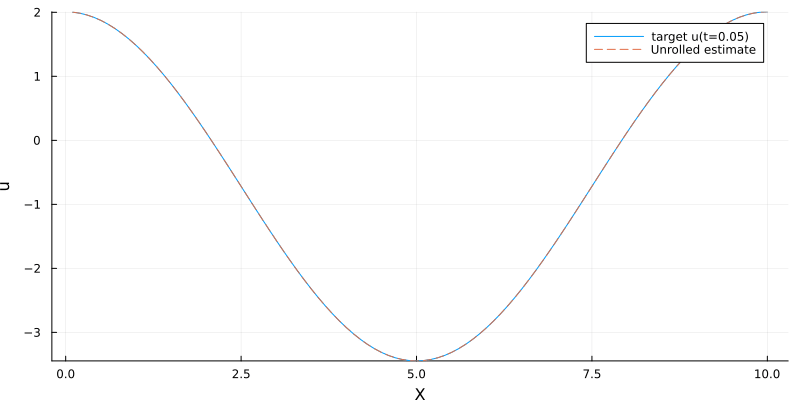

In [28]:
display("image/gif", read("media/dt_model_u_amp0_9_rich.gif"))

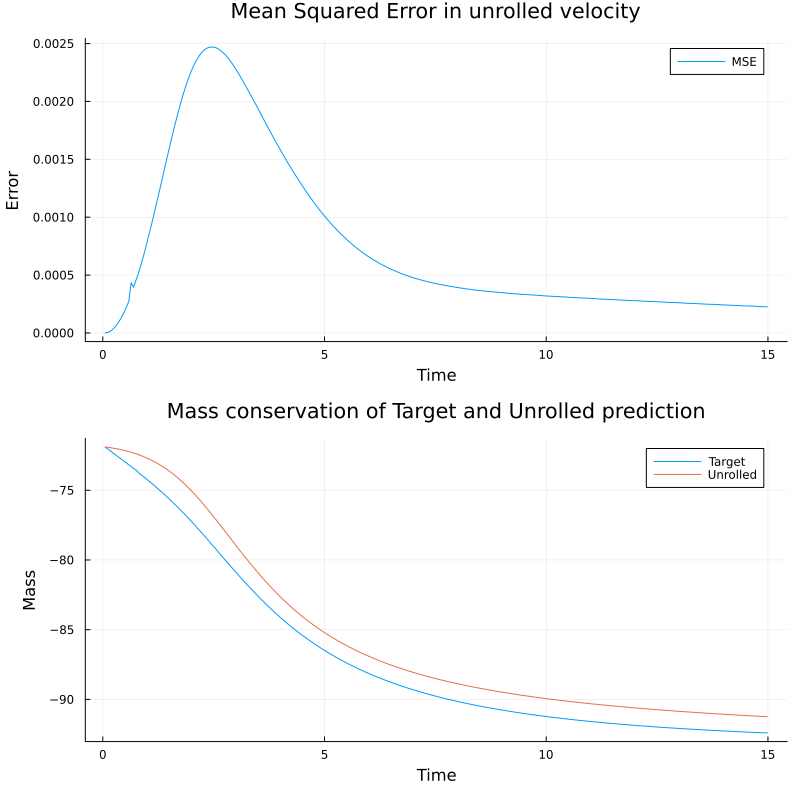

In [29]:
display("image/png", read("media/dt_model_u_amp0_9_rich.png"))